In [8]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [9]:
data = pd.read_csv('data/train.csv', sep=",", encoding = "ISO-8859-1")

data_test_nolabel = pd.read_csv('data/test_nolabel.csv', sep=",", encoding = "ISO-8859-1")


In [10]:
df = data.copy()
df_test_nolabel = data_test_nolabel.copy()

In [11]:
print(df.shape)
print(df_test_nolabel.shape)

(49320, 22)
(7994, 21)


In [12]:
df.head()

,id,LoanNr_ChkDgt,Name,City,State,Bank,BankState,ApprovalDate,ApprovalFY,NoEmp,...,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,Accept
0,d30838cf806,6340864010,QUALITY DOCUMENT SOLUTIONS INC,ODESSA,TX,WELLS FARGO BANK NATL ASSOC,SD,22-May-03,2003,10,...,10,1,1,0,N,NaN,30-Jun-03,"$150,000.00",$0.00,1
1,14560b856a6,1670916004,ATLANTIC INDUSTRIAL WOOD PRODU,KELLER,TX,WELLS FARGO BANK NATL ASSOC,CA,7-Apr-06,2006,1,...,1,1,1,Y,N,NaN,31-Jul-06,"$250,000.00",$0.00,1
2,051e5c3899f,7568313003,C J TREEHOUSE INC.,EL PASO,TX,BANK OF AMERICA NATL ASSOC,TX,12-Sep-94,1994,5,...,0,1,0,N,Y,NaN,31-Oct-94,"$53,000.00",$0.00,1
3,eb223b05ea8,4585814005,WINGSTOP,SAN ANTONIO,TX,COMPASS BANK,AL,18-Jun-01,2001,1,...,1,89769,1,0,N,NaN,31-Aug-01,"$170,000.00",$0.00,1
4,c80c89ac964,2003866003,H & H MACHINE & SUPPLY INC,ODESSA,TX,SOUTHWEST BANK,TX,12-May-06,2006,5,...,5,1,1,0,N,NaN,31-May-06,"$121,000.00",$0.00,1


In [13]:
df.dtypes

id                    object
LoanNr_ChkDgt          int64
Name                  object
City                  object
State                 object
Bank                  object
BankState             object
ApprovalDate          object
ApprovalFY            object
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr             object
LowDoc                object
ChgOffDate            object
DisbursementDate      object
DisbursementGross     object
BalanceGross          object
Accept                 int64
dtype: object

<AxesSubplot:ylabel='None'>

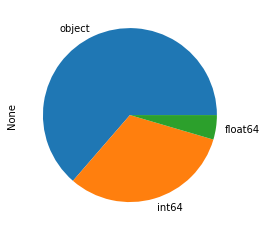

In [14]:
df.dtypes.value_counts().plot.pie()

There are many data with types "Object"

<AxesSubplot:>

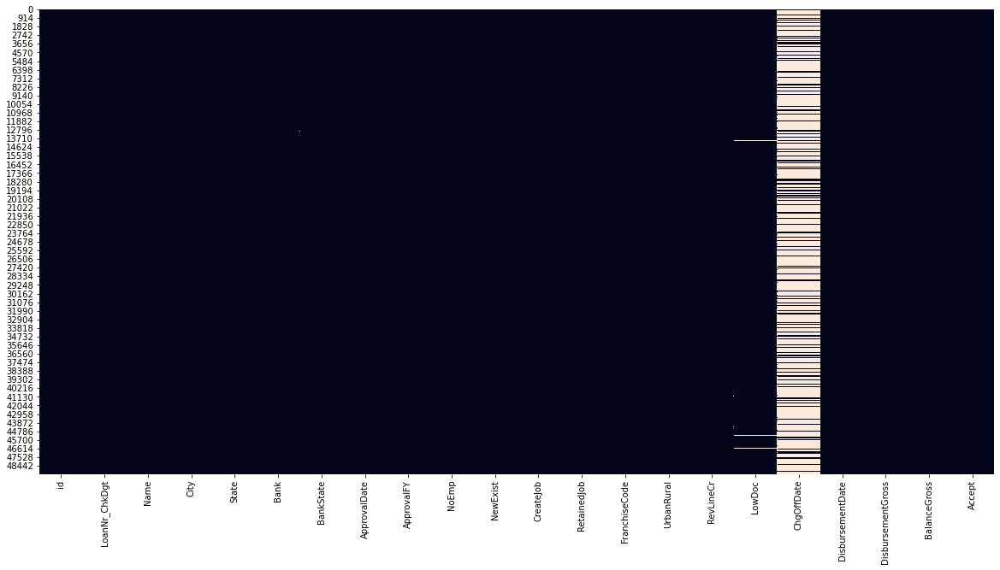

In [15]:
plt.figure(figsize=(20,10))
sns.heatmap(df.isna(), cbar=False)

In [16]:
(df.isna().sum()/df.shape[0]).sort_values(ascending=True)

id                   0.000000
DisbursementGross    0.000000
UrbanRural           0.000000
FranchiseCode        0.000000
RetainedJob          0.000000
CreateJob            0.000000
BalanceGross         0.000000
NoEmp                0.000000
Accept               0.000000
ApprovalDate         0.000000
State                0.000000
City                 0.000000
LoanNr_ChkDgt        0.000000
ApprovalFY           0.000000
Name                 0.000020
NewExist             0.000142
DisbursementDate     0.002555
LowDoc               0.003244
BankState            0.004055
Bank                 0.004055
RevLineCr            0.005860
ChgOffDate           0.805941
dtype: float64

We can delete the column 'State' because we only have the value 'TX'.

In [17]:
df.drop(['State'], axis=1, inplace=True)
df_test_nolabel.drop(['State'], axis=1, inplace=True)

We can delete the column 'BalanceGross' because we only have the value '$0.00 '.

In [18]:
df.drop(['BalanceGross'], axis=1, inplace=True)
df_test_nolabel.drop(['BalanceGross'], axis=1, inplace=True)

In [19]:
df.drop(['Name'], axis=1, inplace=True)
df_test_nolabel.drop(['Name'], axis=1, inplace=True)

In [20]:
print(df.shape)
print(df_test_nolabel.shape)

(49320, 19)
(7994, 18)


## ChgOffDate

In [21]:
df['ChgOffDate'] = df['ChgOffDate'].fillna(1)
df_test_nolabel['ChgOffDate'] = df_test_nolabel['ChgOffDate'].fillna(1)

In [22]:
for i in range(len(df)):
    
    if df['ChgOffDate'][i] != 1 :
        
        df['ChgOffDate'][i] = 0

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [23]:
for i in range(len(df_test_nolabel)):
    
    if df_test_nolabel['ChgOffDate'][i] != 1 :
        
        df_test_nolabel['ChgOffDate'][i] = 0

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [24]:
df['ChgOffDate'].value_counts()

1    39749
0     9571
Name: ChgOffDate, dtype: int64

In [25]:
df_test_nolabel['ChgOffDate'].value_counts()

0    4018
1    3976
Name: ChgOffDate, dtype: int64

## DisbursementGross

Let's change the format of the "DisbursementGross" column from this 30-Jun-03 to 3 columns with the day, the moth and the year associated.

In [26]:
df.fillna(0, inplace= True)
df_test_nolabel.fillna(0, inplace=True)

In [27]:
df['DisbursementDate']

0        30-Jun-03
1        31-Jul-06
2        31-Oct-94
3        31-Aug-01
4        31-May-06
           ...    
49315    31-Mar-02
49316    30-Sep-05
49317    31-Jan-94
49318    31-Oct-07
49319    31-Dec-96
Name: DisbursementDate, Length: 49320, dtype: object

We change the format into datetime

In [28]:
df['DisbursementDate'] = pd.to_datetime(data['DisbursementDate'])
df_test_nolabel['DisbursementDate'] = pd.to_datetime(data['DisbursementDate'])

We create new columns ''DisbursementDay', 'DisbursementMonth', 'DisbursementYear'

In [29]:
df['DisbursementDay'] = df['DisbursementDate'].apply(lambda x: x.day)
df_test_nolabel['DisbursementDay'] = df_test_nolabel['DisbursementDate'].apply(lambda x: x.day)

In [30]:
df['DisbursementDay']

0        30.0
1        31.0
2        31.0
3        31.0
4        31.0
         ... 
49315    31.0
49316    30.0
49317    31.0
49318    31.0
49319    31.0
Name: DisbursementDay, Length: 49320, dtype: float64

In [31]:
df['DisbursementMonth'] = df['DisbursementDate'].apply(lambda x: x.month)
df_test_nolabel['DisbursementMonth'] = df_test_nolabel['DisbursementDate'].apply(lambda x: x.month)

In [32]:
df['DisbursementMonth'] 

0         6.0
1         7.0
2        10.0
3         8.0
4         5.0
         ... 
49315     3.0
49316     9.0
49317     1.0
49318    10.0
49319    12.0
Name: DisbursementMonth, Length: 49320, dtype: float64

In [33]:
df['DisbursementYear'] = df['DisbursementDate'].apply(lambda x: x.year)
df_test_nolabel['DisbursementYear'] = df_test_nolabel['DisbursementDate'].apply(lambda x: x.year)

In [34]:
df['DisbursementYear'] 

0        2003.0
1        2006.0
2        1994.0
3        2001.0
4        2006.0
          ...  
49315    2002.0
49316    2005.0
49317    1994.0
49318    2007.0
49319    1996.0
Name: DisbursementYear, Length: 49320, dtype: float64

We can now delete the 'DisbursementDate' column.

In [35]:
df.drop(['DisbursementDate'], axis=1, inplace=True)
df_test_nolabel.drop(['DisbursementDate'], axis=1, inplace=True)

## ApprovalDate

Let's change the format of the "ApprovalDate" column from this 30-Jun-03 to 3 columns with the day, the moth and the year associated.

In [36]:
df['ApprovalDate']

0        22-May-03
1         7-Apr-06
2        12-Sep-94
3        18-Jun-01
4        12-May-06
           ...    
49315    23-Oct-01
49316     4-Aug-05
49317     3-Aug-93
49318    21-Sep-07
49319     9-Jul-96
Name: ApprovalDate, Length: 49320, dtype: object

In [37]:
df['ApprovalDate'] = pd.to_datetime(data['ApprovalDate'])
df_test_nolabel['ApprovalDate'] = pd.to_datetime(data['ApprovalDate'])

In [38]:
df['ApprovalDay'] = df['ApprovalDate'].apply(lambda x: x.day)
df_test_nolabel['ApprovalDay'] = df_test_nolabel['ApprovalDate'].apply(lambda x: x.day)
df['ApprovalMonth'] = df['ApprovalDate'].apply(lambda x: x.month)
df_test_nolabel['ApprovalMonth'] = df_test_nolabel['ApprovalDate'].apply(lambda x: x.month)
df['ApprovalYear'] = df['ApprovalDate'].apply(lambda x: x.year)
df_test_nolabel['ApprovalYear'] = df_test_nolabel['ApprovalDate'].apply(lambda x: x.year)

In [39]:
df.drop(['ApprovalDate'], axis=1, inplace=True)
df_test_nolabel.drop(['ApprovalDate'], axis=1, inplace=True)

## DisbursementGross

Let's change the format of the "DisbursementGross" column from this $ 150,000.00 to 150000.

In [40]:
df['DisbursementGross']

0        $150,000.00 
1        $250,000.00 
2         $53,000.00 
3        $170,000.00 
4        $121,000.00 
             ...     
49315     $63,000.00 
49316     $25,000.00 
49317    $200,000.00 
49318     $35,000.00 
49319     $90,000.00 
Name: DisbursementGross, Length: 49320, dtype: object

In [41]:
def clean_currency(x):
   
    if isinstance(x, str):
        return(x.replace('$', '').replace(',', ''))
    return(x)

In [42]:
df['DisbursementGross'] = df['DisbursementGross'].apply(clean_currency).astype('float')
df_test_nolabel['DisbursementGross'] = df_test_nolabel['DisbursementGross'].apply(clean_currency).astype('float')

In [43]:
df_test_nolabel['DisbursementGross']

0        467500.0
1          5000.0
2         46500.0
3         69479.0
4         37500.0
          ...    
7989    2000000.0
7990      71500.0
7991      19000.0
7992     500000.0
7993     150000.0
Name: DisbursementGross, Length: 7994, dtype: float64

In [44]:
df.fillna(0, inplace=True)
df_test_nolabel.fillna(0, inplace=True)

## For the other columns of type 'Object' we will create a function which associates to the Strings a value.

### City

In [45]:
City = []

lista_2 = dict()

for i in range (0, 49320):
    
    City.append(df['City'][i])
    
for j in range (0, 49320):
        
    if df['City'][j] not in lista_2:
        
        
        c = City[j]
        
        df['City'][j] = j
    
        lista_2[c] = j
        
        print(c)
        
        print(df['City'][j])
        
        print(lista_2)
        
    else :
        
        df['City'][j] = lista_2[df['City'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


ODESSA
0
{'ODESSA': 0}
KELLER
1
{'ODESSA': 0, 'KELLER': 1}
EL PASO
2
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2}
SAN ANTONIO
3
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3}
FORT WORTH
5
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5}
ARLINGTON
6
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6}
CEDAR HILL
7
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7}
MIDLAND
8
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8}
AUSTIN
9
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9}
KATY
10
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10}
HOUSTON
11
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3

LONGVIEW
305
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

FT. STOCKTON
595
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

COMFORT
858
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

WOLFE CITY
1121
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

AZLE
1420
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 

SEAGOVILLE
1697
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

WILLOWPARK
1981
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

MUENSTER
2294
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

BECKVILLE
2594
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

ELM MOTT
2888
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

SALTILLO
3200
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

THREE RIVERS
3505
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



MERTZON
5667
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

EL CAMPA
5985
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

Franklin
6378
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

MT. PLEASANT
6716
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

FLATONIA
7085
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

McKinney
7381
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

Fort Bliss
7740
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

ELCAMPO
8062
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

ALBANY
8334
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

Weatherford
8718
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

San Angelo
9039
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

RED OAK
9366
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

EVERMAN
9726
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

NORWALK
10087
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



GEORGE WEST
11442
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

TRINITY
11921
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

HORIZON CITY
12296
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

GAINSESVILLE
12661
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

KELLEEN
12995
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

MOODY
13321
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

ALINE
13655
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

LUCAS
14060
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

GRANDFALLS
14451
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

RAYMONDVILLE
14807
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

BRASHEAR
15126
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

OZONA
15478
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

BLANCO
15786
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

MEADOW
16254
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




17239
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105

Benbrook
17677
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

OAK POINT
18048
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

Alvin
18387
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

CELLINAS
18712
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

Nassau Bay
19192
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

DOUGLASVILLE
19511
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

MESQUIATE
19835
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

Lufkin
20241
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

SANTA ROSA
20627
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

LAGO VISTE
20978
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

BUTLESON
21388
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

ARTESIA
21753
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

ALTO
22167
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

Needville
22468
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

SAN MARCO
22852
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




23886
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105

MGNOLIA
24355
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

ADDICKS
24964
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

NOCOGDOCHES
25571
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

BIG SPRINGS
25908
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

TEXHOMA
26322
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

ADKINS
26658
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

EAST TEXAS CENTER
27012
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101

Spicewood
27380
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

Gilmer
27711
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

Jarrell
28074
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

TUSCOLA
28398
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



HALTON CITY
30053
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

La porte
30393
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

CHANNEL VIEW
30704
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

BETHANY
31146
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

CUMBY
31475
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

TRENTON
31871
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

BRAZONA
32381
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

TOM BEAN
32802
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

IRVING,  TX
33189
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

RICHWOOD VILLAGE (CORPORATE NA
33624
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 

The Woodlands, TX
33934
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101

MORGANS POINT
34247
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'S

TATUM
34612
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

West Columbia
35107
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'S

Seminole
35477
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

CROSS ROADS
35823
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

TORNILLO
36217
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

JACKSONVILLES
36614
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'S

HEDWIG VILLAGE
36991
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, '

Henderson
37359
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

NACAGDOCHES
37730
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

BELMONT
38050
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

FRIENSWOOD
38623
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

Frankston
38998
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

WICHITA FALL
39352
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

NEW ULM
39740
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

Falcon heights
40082
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, '

BARTUP
40597
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

POLLOK
40939
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

Uvalde
41424
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

LAKE JACKSON,
41888
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'S

PARKER
42259
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

MAYPEARL
42657
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




44457
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105

COLORAD CITY
44882
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

SANGAR
45300
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

Bay City
45648
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

CLODINA
46029
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

LEWISTOWN
46351
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

Edinberg
46690
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

BON WIER
47232
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

THE WOODLAND
47650
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

DALLASQ
47933
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

Canyon Lake
48267
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

Prosper
48666
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

HART
48996
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

In [46]:
City_test = []
lista_2_test = dict()

for i in range (0, 7994):
    City_test.append(df_test_nolabel['City'][i])
    
for j in range (0, 7994):
    
    if df_test_nolabel['City'][j] not in lista_2_test:
        c = City_test[j]
        df_test_nolabel['City'][j] = j
        lista_2_test[c] = j
        print(c)
        print(df_test_nolabel['City'][j])
        print(lista_2_test)
        
    else :
        df_test_nolabel['City'][j] = lista_2_test[df_test_nolabel['City'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


BAYTOWN
0
{'BAYTOWN': 0}
HOUSTON
1
{'BAYTOWN': 0, 'HOUSTON': 1}
AUSTIN
2
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2}
TOMBALL
3
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3}
HUTCHINS
4
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4}
HUMBLE
5
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5}
CORPUS CHRISTI
6
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6}
LUBBOCK
7
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7}
LEWISVILLE
8
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8}
DALLAS
9
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9}
PLANO
10
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBL

GALVESTON
304
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109

DEER PARK
600
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109

SPRINGTOWN
866
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 10

BORGER
1187
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 

GONZALES
1485
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109

NEW BRAUFELS
1798
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT':

The Colony
2139
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 1

2475
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 'PORT A

TYNAN
2804
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, '

MALAKOFF
3128
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109

AUBREY
3499
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 

STRATFORD
3862
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 10

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 'PORT ARANS

THE WOODLAND
7182
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT':

Lewisville
7557
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 1

BARTON
7944
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 

In [47]:
df_test_nolabel['City']

0         0
1         1
2         2
3         3
4         4
       ... 
7989    261
7990     10
7991    628
7992     10
7993     44
Name: City, Length: 7994, dtype: object

### Bank

In [48]:
name_bank = []

lista = dict()

for i in range (0, 49320):
    
    name_bank.append(df['Bank'][i])
    
for j in range (0, 49320):
        
    if df['Bank'][j] not in lista:
        
        
        c = name_bank[j]
        
        df['Bank'][j] = j
    
        lista[c] = j
        
        print(c)
        
        print(df['Bank'][j])
        
        print(lista)
        
    else :
        
        df['Bank'][j] = lista[df['Bank'][j]]
    

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


WELLS FARGO BANK NATL ASSOC
0
{'WELLS FARGO BANK NATL ASSOC': 0}
BANK OF AMERICA NATL ASSOC
2
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2}
COMPASS BANK
3
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3}
SOUTHWEST BANK
4
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4}
BUSINESS LOAN CENTER, LLC
5
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5}
COMMUNITY BANK
6
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6}
JPMORGAN CHASE BANK NATL ASSOC
7
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7}
PROSPERITY BANK
8
{'WELLS FARGO BA

FIRST COMMUN BANK NATL ASSOC
264
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

FIRST STATE BANK CENTRAL TEXAS
527
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'F

BANK - AMERICA NATL ASSOC
822
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

YOAKUM NATIONAL BANK
1156
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

TEXAS FIRST BANK - TEXAS CITY
1509
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'F

1ST NATL BK OF BEEVILLE
1856
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

FIRST NATIONAL BANK TEXAS
2197
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST

GREATER E. TEXAS CERT. DEVEL C
2637
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, '

COMMUNITY CERT. DEVEL CORP
2954
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

BANK OF HAYS
3460
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, '

CITY NATL BK OF TAYLOR
3889
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

STATE BANK OF DE KALB
4219
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

NORTH TEXAS REGIONAL
4732
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

BANKUNITED NATL ASSOC
5133
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

TEXAS HERITAGE BANK
5525
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

1ST CHOICE BANK
6066
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

NATIONAL BANK & TRUST
6372
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

FIRST BANK NATL ASSOC
6862
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

MILLS COUNTY STATE BANK
7212
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

CLASSIC BANK NATL ASSOC
7595
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

HASKELL NATIONAL BANK
7939
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

COMMERCIAL NATIONAL CORP
8272
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

FIRST BK & TR OF CHILDRESS
8910
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

TEXAS CHAMPION BANK
9298
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

LEA COUNTY STATE BANK
9669
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

CATHAY BANK
10049
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, '

CITY NATIONAL BANK
10795
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

THE NORTHERN TRUST COMPANY
11011
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, 'TEJAS BANK': 84, '

HILL BANK & TRUST CO.
11775
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

EH NATIONAL BANK
12174
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 

FDIC/FIRST NATL BK - GEORGETOW
12706
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

PLAINS STATE BANK
13121
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK':

ACCESSBANK TEXAS
13545
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 

FARMERS EXCHANGE BANK
13876
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

14329
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, 'TEJAS BANK':

VANTAGE BANK TEXAS
14756
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

SMS FINANCIAL, LLC
15160
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

DALHART FED. S & L ASSOCIATION
15582
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

FIRST STATE COMMUNITY BANK
15892
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

AMEGY BANK NATL ASSOC
16586
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

THE SECURITY STATE BANK
17348
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

INTERSTATE BANK, SSB
17761
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

CAPITAL BANK NATL ASSOC
18149
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

FDIC/ HERITAGE NATIONAL BANK
18898
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'F

COMM. SERVICES OF PERRY INC
19601
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

FIRST NATIONAL BANK OF TRENTON
20599
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

FIRST BETHANY BANK & TRUST
21034
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

TIB- INDEP BANKERSBANK
21436
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

CENDERA BANK NATL ASSOC
22470
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

WORTHINGTON NATIONAL BANK
22971
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

REPUBLICBANKAZ NATL ASSOC
23553
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

FIRST STATE BANK OF UVALDE
24170
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

FDIC/FARMERS & MERCHANTS BK OF
24563
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

EVOLVE BANK & TRUST
24957
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

FIRST NATIONAL BANK OF TRINITY
25469
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

BANK OF NO. GEORGIA A DIVISION
26146
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

THE LYON COUNTY STATE BANK
26607
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

GULF COAST BK & TR CO
27065
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

MASON BANK
27503
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, 'T

NEBRASKA BANK OF COMMERCE
28104
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

MEMORIAL CITY BANK
28549
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

XCEED FINANCIAL FCU
29164
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

BRIDGE CITY STATE BANK
30058
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

SOUTHSIDE BANCSHARES, INC.
30937
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

BANK OF CORDELL
31827
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 7

FDIC/CITIZENS NAT BK-KERRVILLE
32546
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

DILLEY STATE BANK
32944
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK':

COLUMBUS STATE BANK
33392
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

WEST TEXAS CU
33846
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77,

FIRST TEXOMA NATIONAL BANK
34346
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

VALLIANCE BANK
34850
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

1ST NATL BK & TR CO OF OKMULG
35574
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, '

WASHINGTONFIRST BANK
36116
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

INDUSTRY STATE BANK
36760
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

UNITED COMMUNITY BANK
37261
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

TEXAS REP. BANK NATL ASSOC
37787
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

LOUISIANA CAP. CERT. DEVEL COM
38151
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

FDIC/RIVERSIDE NATIONAL BANK
38729
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'F

FDIC/NBC-SEGUIN
39362
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 7

BRENHAM INDUSTRIAL FOUNDATION
39825
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, '

HOMETRUST BANK
40404
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

AMER NATL BK - TEXAS
41588
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

HAWTHORN BANK
42445
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77,

FDIC/LAND BANK
43082
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

HART CNTY BK & TR CO
43838
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

AMERICAN BANK AND TRUST CO.
44342
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

ONE GEORGIA BANK
44784
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 

BRYAN-COLLEGE STATION CDC
45512
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

TOWN & COUNTRY BANCSHARES, INC
46204
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

THE BANCORP BANK
46686
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 

EMPIRE BANK
47124
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, '

INVESTORS BANK
47672
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

TEXAS GULF BANK NATL ASSOC
48111
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

GRAPELAND STATE BANK
48477
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

SHINHAN BANK AMERICA
49229
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

In [49]:
name_bank_test = []
lista_test = dict()

for i in range (0, 7994):
    name_bank_test.append(df_test_nolabel['Bank'][i])
    
for j in range (0, 7994):
    
    if df_test_nolabel['Bank'][j] not in lista_test:
        c = name_bank_test[j]
        df_test_nolabel['Bank'][j] = j
        lista_test[c] = j
        print(c)
        print(df_test_nolabel['Bank'][j])
        print(lista_test)
        
    else :
        df_test_nolabel['Bank'][j] = lista_test[df_test_nolabel['Bank'][j]]

COMERICA BANK
0
{'COMERICA BANK': 0}
BBCN BANK
1
{'COMERICA BANK': 0, 'BBCN BANK': 1}
BANK OF AMERICA NATL ASSOC
2
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2}
JPMORGAN CHASE BANK NATL ASSOC
3
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3}
RTC/PADRE FEDERAL S&L
6
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6}
FIRST UNITED BANK
7
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7}
BANCO POPULAR NORTH AMERICA
10
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10}
CEN-TEX CERT. DEVEL CORP
12
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHAS

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



50
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50}
EAST WEST BANK
51
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC

WESTSTAR BANK
255
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXAS 

RIO BANK
337
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXAS CERT.

CITIZENS BANK
647
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXAS 

FIRST STATE BANK
967
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEX

FIRST FINANCIAL BANK
990
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E.

OZONA NATIONAL BANK
1299
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E.

TRANSAMERICA SMALL BUS. CAPITA
1727
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 

ARK-TEX REGIONAL DEVEL COMPANY
2048
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 

COMMUNITY NATL BK & TR OF TEXA
2452
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 

CROCKETT NATIONAL BANK
2817
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER

HAMLIN NATIONAL BANK
3306
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E

BANCFIRST
3867
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXAS CER

NORTHSTAR BANK OF TEXAS
4253
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATE

CARMINE STATE BANK
4649
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. 

FDIC/WESTSIDE NATIONAL BANK
5030
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GR

WELLINGTON STATE BANK
5412
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER 

1ST NATL BK OF NEW MEXICO
6067
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREA

FIRST NATL BANK WICHITA FALLS
6461
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, '

KLEIN BANCSHARES, INC
6925
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER 

1ST NATL BK OF EAGLE LAKE
7347
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREA

FDIC/FIRST CONSOLIDATED BANK
7946
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'G

### BankState

In [50]:
BankState = []

lista_4 = dict()

for i in range (0, 49320):
    
    BankState.append(df['BankState'][i])
    
for j in range (0, 49320):
        
    if df['BankState'][j] not in lista_4:
        
        
        c = BankState[j]
        
        df['BankState'][j] = j
    
        lista_4[c] = j
        
        print(c)
        
        print(df['BankState'][j])
        
        print(lista_4)
        
    else :
        
        df['BankState'][j] = lista_4[df['BankState'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


SD
0
{'SD': 0}
CA
1
{'SD': 0, 'CA': 1}
TX
2
{'SD': 0, 'CA': 1, 'TX': 2}
AL
3
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3}
SC
5
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5}
IL
7
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7}
DC
17
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17}
NC
20
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20}
MO
30
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30}
OR
32
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32}
VA
49
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49}
OH
86
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86}
NV
118
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86, 'NV': 118}
FL
162
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC'

PR
7879
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86, 'NV': 118, 'FL': 162, 'CT': 182, 'NY': 194, 'UT': 217, 'NM': 230, 'CO': 311, 'MS': 419, 'MN': 440, 'AR': 544, 'OK': 695, 0: 946, 'NE': 972, 'RI': 1011, 'GA': 1364, 'MI': 1523, 'IN': 1722, 'TN': 1901, 'DE': 1991, 'LA': 2413, 'KS': 3460, 'WI': 3622, 'PA': 4306, 'ME': 4335, 'IA': 5523, 'AZ': 5800, 'WA': 6638, 'MD': 6901, 'PR': 7879}
MA
9347
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86, 'NV': 118, 'FL': 162, 'CT': 182, 'NY': 194, 'UT': 217, 'NM': 230, 'CO': 311, 'MS': 419, 'MN': 440, 'AR': 544, 'OK': 695, 0: 946, 'NE': 972, 'RI': 1011, 'GA': 1364, 'MI': 1523, 'IN': 1722, 'TN': 1901, 'DE': 1991, 'LA': 2413, 'KS': 3460, 'WI': 3622, 'PA': 4306, 'ME': 4335, 'IA': 5523, 'AZ': 5800, 'WA': 6638, 'MD': 6901, 'PR': 7879, 'MA': 9347}
KY
9581
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC':

In [51]:
BankState_test = []
lista_4_test = dict()

for i in range (0, 7994):
    BankState_test.append(df_test_nolabel['BankState'][i])
    
for j in range (0, 7994):

    if df_test_nolabel['BankState'][j] not in lista_4_test:
        c = BankState[j]
        df_test_nolabel['BankState'][j] = j
        lista_4_test[c] = j
        print(c)
        print(df_test_nolabel['BankState'][j])
        print(lista_4_test)
        
    else :
        df_test_nolabel['BankState'][j] = lista_4_test[df_test_nolabel['BankState'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


SD
0
{'SD': 0}
CA
1
{'SD': 0, 'CA': 1}
TX
2
{'SD': 0, 'CA': 1, 'TX': 2}
AL
3
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3}
TX
4
{'SD': 0, 'CA': 1, 'TX': 4, 'AL': 3}
TX
6
{'SD': 0, 'CA': 1, 'TX': 6, 'AL': 3}
TX
8
{'SD': 0, 'CA': 1, 'TX': 8, 'AL': 3}
TX
10
{'SD': 0, 'CA': 1, 'TX': 10, 'AL': 3}
TX
11
{'SD': 0, 'CA': 1, 'TX': 11, 'AL': 3}
IL
13
{'SD': 0, 'CA': 1, 'TX': 11, 'AL': 3, 'IL': 13}
TX
25
{'SD': 0, 'CA': 1, 'TX': 25, 'AL': 3, 'IL': 13}
TX
27
{'SD': 0, 'CA': 1, 'TX': 27, 'AL': 3, 'IL': 13}
AL
28
{'SD': 0, 'CA': 1, 'TX': 27, 'AL': 28, 'IL': 13}
MO
30
{'SD': 0, 'CA': 1, 'TX': 27, 'AL': 28, 'IL': 13, 'MO': 30}
TX
35
{'SD': 0, 'CA': 1, 'TX': 35, 'AL': 28, 'IL': 13, 'MO': 30}
SD
43
{'SD': 43, 'CA': 1, 'TX': 35, 'AL': 28, 'IL': 13, 'MO': 30}
IL
48
{'SD': 43, 'CA': 1, 'TX': 35, 'AL': 28, 'IL': 48, 'MO': 30}
IL
52
{'SD': 43, 'CA': 1, 'TX': 35, 'AL': 28, 'IL': 52, 'MO': 30}
SD
65
{'SD': 65, 'CA': 1, 'TX': 35, 'AL': 28, 'IL': 52, 'MO': 30}
SD
66
{'SD': 66, 'CA': 1, 'TX': 35, 'AL': 28, 'IL': 52, 'MO':

NC
1345
{'SD': 1053, 'CA': 1298, 'TX': 1273, 'AL': 1215, 'IL': 1286, 'MO': 30, 'VA': 1211, 'OR': 285, 'NC': 1345, 'NY': 194, 'SC': 1222, 'NV': 571, 'OH': 1235}
CA
1359
{'SD': 1053, 'CA': 1359, 'TX': 1273, 'AL': 1215, 'IL': 1286, 'MO': 30, 'VA': 1211, 'OR': 285, 'NC': 1345, 'NY': 194, 'SC': 1222, 'NV': 571, 'OH': 1235}
SC
1402
{'SD': 1053, 'CA': 1359, 'TX': 1273, 'AL': 1215, 'IL': 1286, 'MO': 30, 'VA': 1211, 'OR': 285, 'NC': 1345, 'NY': 194, 'SC': 1402, 'NV': 571, 'OH': 1235}
IL
1406
{'SD': 1053, 'CA': 1359, 'TX': 1273, 'AL': 1215, 'IL': 1406, 'MO': 30, 'VA': 1211, 'OR': 285, 'NC': 1345, 'NY': 194, 'SC': 1402, 'NV': 571, 'OH': 1235}
TX
1454
{'SD': 1053, 'CA': 1359, 'TX': 1454, 'AL': 1215, 'IL': 1406, 'MO': 30, 'VA': 1211, 'OR': 285, 'NC': 1345, 'NY': 194, 'SC': 1402, 'NV': 571, 'OH': 1235}
SD
1456
{'SD': 1456, 'CA': 1359, 'TX': 1454, 'AL': 1215, 'IL': 1406, 'MO': 30, 'VA': 1211, 'OR': 285, 'NC': 1345, 'NY': 194, 'SC': 1402, 'NV': 571, 'OH': 1235}
CA
1469
{'SD': 1456, 'CA': 1469, 'TX': 1

NC
3079
{'SD': 2698, 'CA': 2368, 'TX': 2993, 'AL': 2770, 'IL': 2994, 'MO': 30, 'VA': 1211, 'OR': 285, 'NC': 3079, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235}
TX
3080
{'SD': 2698, 'CA': 2368, 'TX': 3080, 'AL': 2770, 'IL': 2994, 'MO': 30, 'VA': 1211, 'OR': 285, 'NC': 3079, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235}
TX
3089
{'SD': 2698, 'CA': 2368, 'TX': 3089, 'AL': 2770, 'IL': 2994, 'MO': 30, 'VA': 1211, 'OR': 285, 'NC': 3079, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235}
TX
3090
{'SD': 2698, 'CA': 2368, 'TX': 3090, 'AL': 2770, 'IL': 2994, 'MO': 30, 'VA': 1211, 'OR': 285, 'NC': 3079, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235}
TX
3128
{'SD': 2698, 'CA': 2368, 'TX': 3128, 'AL': 2770, 'IL': 2994, 'MO': 30, 'VA': 1211, 'OR': 285, 'NC': 3079, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235}
SD
3157
{'SD': 3157, 'CA': 2368, 'TX': 3128, 'AL': 2770, 'IL': 2994, 'MO': 30, 'VA': 1211, 'OR': 285, 'NC': 3079, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235}
SD
3246
{'SD': 3246, 'CA': 2

TX
4671
{'SD': 4528, 'CA': 3536, 'TX': 4671, 'AL': 4286, 'IL': 4068, 'MO': 30, 'VA': 4234, 'OR': 285, 'NC': 4154, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235, 'DC': 4050, 'OK': 4365, 'FL': 4441}
TX
4678
{'SD': 4528, 'CA': 3536, 'TX': 4678, 'AL': 4286, 'IL': 4068, 'MO': 30, 'VA': 4234, 'OR': 285, 'NC': 4154, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235, 'DC': 4050, 'OK': 4365, 'FL': 4441}
TX
4698
{'SD': 4528, 'CA': 3536, 'TX': 4698, 'AL': 4286, 'IL': 4068, 'MO': 30, 'VA': 4234, 'OR': 285, 'NC': 4154, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235, 'DC': 4050, 'OK': 4365, 'FL': 4441}
TX
4713
{'SD': 4528, 'CA': 3536, 'TX': 4713, 'AL': 4286, 'IL': 4068, 'MO': 30, 'VA': 4234, 'OR': 285, 'NC': 4154, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235, 'DC': 4050, 'OK': 4365, 'FL': 4441}
TX
4714
{'SD': 4528, 'CA': 3536, 'TX': 4714, 'AL': 4286, 'IL': 4068, 'MO': 30, 'VA': 4234, 'OR': 285, 'NC': 4154, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235, 'DC': 4050, 'OK': 4365, 'FL': 4441}
NC
4851
{'

SD
7069
{'SD': 7069, 'CA': 4941, 'TX': 6772, 'AL': 6498, 'IL': 7022, 'MO': 30, 'VA': 6627, 'OR': 6775, 'NC': 5766, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235, 'DC': 4050, 'OK': 4365, 'FL': 4441, 'MD': 6901}
IL
7078
{'SD': 7069, 'CA': 4941, 'TX': 6772, 'AL': 6498, 'IL': 7078, 'MO': 30, 'VA': 6627, 'OR': 6775, 'NC': 5766, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235, 'DC': 4050, 'OK': 4365, 'FL': 4441, 'MD': 6901}
SD
7118
{'SD': 7118, 'CA': 4941, 'TX': 6772, 'AL': 6498, 'IL': 7078, 'MO': 30, 'VA': 6627, 'OR': 6775, 'NC': 5766, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235, 'DC': 4050, 'OK': 4365, 'FL': 4441, 'MD': 6901}
TX
7141
{'SD': 7118, 'CA': 4941, 'TX': 7141, 'AL': 6498, 'IL': 7078, 'MO': 30, 'VA': 6627, 'OR': 6775, 'NC': 5766, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH': 1235, 'DC': 4050, 'OK': 4365, 'FL': 4441, 'MD': 6901}
TX
7147
{'SD': 7118, 'CA': 4941, 'TX': 7147, 'AL': 6498, 'IL': 7078, 'MO': 30, 'VA': 6627, 'OR': 6775, 'NC': 5766, 'NY': 2035, 'SC': 2717, 'NV': 1782, 'OH':

### ApprovalFY

In [52]:
ApprovalFY = []

lista_6 = dict()

for i in range (0, 49320):
    
    ApprovalFY.append(df['ApprovalFY'][i])
    
for j in range (0, 49320):
        
    if df['ApprovalFY'][j] not in lista_6:
        
        
        c = ApprovalFY[j]
        
        df['ApprovalFY'][j] = j
    
        lista_6[c] = j
        
        print(c)
        
        print(df['ApprovalFY'][j])
        
        print(lista_6)
        
    else :
        
        df['ApprovalFY'][j] = lista_6[df['ApprovalFY'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2003
0
{'2003': 0}
2006
1
{'2003': 0, '2006': 1}
1994
2
{'2003': 0, '2006': 1, '1994': 2}
2001
3
{'2003': 0, '2006': 1, '1994': 2, '2001': 3}
2004
5
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5}
2008
7
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7}
1992
10
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10}
1999
12
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12}
2000
15
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15}
2007
21
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21}
2002
22
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22}
1990
23
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22, '1990': 23}
2005
27
{'2003': 0,

1982
3505
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22, '1990': 23, '2005': 27, '1995': 28, '1989': 29, '1998': 31, '1991': 41, '2009': 45, '2011': 65, '1993': 84, '2010': 92, '1997': 96, '1996': 101, '1980': 144, '1986': 161, '1987': 178, '1988': 221, '2012': 335, '1984': 556, '1985': 675, '1981': 1013, '2013': 1086, '1978': 1139, '2014': 1285, '1979': 1322, '1983': 2295, '1982': 3505}
1977
6545
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22, '1990': 23, '2005': 27, '1995': 28, '1989': 29, '1998': 31, '1991': 41, '2009': 45, '2011': 65, '1993': 84, '2010': 92, '1997': 96, '1996': 101, '1980': 144, '1986': 161, '1987': 178, '1988': 221, '2012': 335, '1984': 556, '1985': 675, '1981': 1013, '2013': 1086, '1978': 1139, '2014': 1285, '1979': 1322, '1983': 2295, '1982': 3505, '1977': 6545}
1974
17697
{'2003': 0, '2006': 1, '1994': 2,

In [53]:
ApprovalFY_test = []
lista_6_test = dict()

for i in range (0, 7994):
    ApprovalFY_test.append(df_test_nolabel['ApprovalFY'][i])
    
for j in range (0, 7994):
    
    if df_test_nolabel['ApprovalFY'][j] not in lista_6_test:
        c = ApprovalFY_test[j]
        df_test_nolabel['ApprovalFY'][j] = j
        lista_6_test[c] = j
        print(c)
        print(df_test_nolabel['ApprovalFY'][j])
        print(lista_6_test)
        
    else :
        df_test_nolabel['ApprovalFY'][j] = lista_6_test[df_test_nolabel['ApprovalFY'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2001
0
{'2001': 0}
2004
1
{'2001': 0, '2004': 1}
2011
3
{'2001': 0, '2004': 1, '2011': 3}
2007
4
{'2001': 0, '2004': 1, '2011': 3, '2007': 4}
2008
5
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5}
1985
6
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6}
2002
7
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7}
2006
8
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8}
2003
10
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10}
1999
12
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12}
1995
15
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12, '1995': 15}
2000
19
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12, '1995': 15, '2000': 19}
1998
22
{'2001': 0, '2004': 1, '

2014
2056
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12, '1995': 15, '2000': 19, '1998': 22, '2005': 23, '1992': 29, '1984': 30, '2010': 31, '1987': 32, '1994': 35, '1996': 38, '2009': 39, '1997': 51, '1993': 55, '1991': 57, '1983': 80, '1975': 89, '1986': 99, '1988': 133, '2012': 174, '1989': 226, '1990': 258, '1982': 282, '1980': 540, '1979': 619, '2013': 849, '1981': 926, '1976': 929, '1977': 1102, '2014': 2056}
1978
3075
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12, '1995': 15, '2000': 19, '1998': 22, '2005': 23, '1992': 29, '1984': 30, '2010': 31, '1987': 32, '1994': 35, '1996': 38, '2009': 39, '1997': 51, '1993': 55, '1991': 57, '1983': 80, '1975': 89, '1986': 99, '1988': 133, '2012': 174, '1989': 226, '1990': 258, '1982': 282, '1980': 540, '1979': 619, '2013': 849, '1981': 926, '1976': 929, '1977': 1102, '2014': 2056, '1978': 3075}
1976A
4170
{'200

### RevLineCr

In [54]:
RevLineCr = []

lista_7 = dict()

for i in range (0, 49320):
    
    RevLineCr.append(df['RevLineCr'][i])
    
for j in range (0, 49320):
        
    if df['RevLineCr'][j] not in lista_7:
        
        
        c = RevLineCr[j]
        
        df['RevLineCr'][j] = j
    
        lista_7[c] = j
        
        print(c)
        
        print(df['RevLineCr'][j])
        
        print(lista_7)
        
    else :
        
        df['RevLineCr'][j] = lista_7[df['RevLineCr'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


0
0
{'0': 0}
Y
1
{'0': 0, 'Y': 1}
N
2
{'0': 0, 'Y': 1, 'N': 2}
T
66
{'0': 0, 'Y': 1, 'N': 2, 'T': 66}
0
145
{'0': 0, 'Y': 1, 'N': 2, 'T': 66, 0: 145}
1
2165
{'0': 0, 'Y': 1, 'N': 2, 'T': 66, 0: 145, '1': 2165}
`
26012
{'0': 0, 'Y': 1, 'N': 2, 'T': 66, 0: 145, '1': 2165, '`': 26012}


In [55]:
RevLineCr_test = []
lista_7_test = dict()

for i in range (0, 7994):
    RevLineCr_test.append(df_test_nolabel['RevLineCr'][i])
    
for j in range (0, 7994):
        
    if df_test_nolabel['RevLineCr'][j] not in lista_7_test:
        c = RevLineCr_test[j]
        df_test_nolabel['RevLineCr'][j] = j
        lista_7_test[c] = j
        print(c)
        print(df_test_nolabel['RevLineCr'][j])
        print(lista_7_test)
        
    else :
        df_test_nolabel['RevLineCr'][j] = lista_7_test[df_test_nolabel['RevLineCr'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


0
0
{'0': 0}
Y
2
{'0': 0, 'Y': 2}
N
5
{'0': 0, 'Y': 2, 'N': 5}
0
125
{'0': 0, 'Y': 2, 'N': 5, 0: 125}
T
380
{'0': 0, 'Y': 2, 'N': 5, 0: 125, 'T': 380}


### LowDoc

In [56]:
LowDoc = []

lista_8 = dict()

for i in range (0, 49320):
    
    LowDoc.append(df['LowDoc'][i])
    
for j in range (0, 49320):
        
    if df['LowDoc'][j] not in lista_8:
        
        
        c = LowDoc[j]
        
        df['LowDoc'][j] = j
    
        lista_8[c] = j
        
        print(c)
        
        print(df['LowDoc'][j])
        
        print(lista_8)
        
    else :
        
        df['LowDoc'][j] = lista_8[df['LowDoc'][j]]
    

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


N
0
{'N': 0}
Y
2
{'N': 0, 'Y': 2}
0
32
{'N': 0, 'Y': 2, 0: 32}
C
346
{'N': 0, 'Y': 2, 0: 32, 'C': 346}
0
587
{'N': 0, 'Y': 2, 0: 32, 'C': 346, '0': 587}
A
1052
{'N': 0, 'Y': 2, 0: 32, 'C': 346, '0': 587, 'A': 1052}
S
2949
{'N': 0, 'Y': 2, 0: 32, 'C': 346, '0': 587, 'A': 1052, 'S': 2949}
R
4615
{'N': 0, 'Y': 2, 0: 32, 'C': 346, '0': 587, 'A': 1052, 'S': 2949, 'R': 4615}


In [57]:
LowDoc_test = []
lista_8_test = dict()

for i in range (0, 7994):
    LowDoc_test.append(df_test_nolabel['LowDoc'][i])
    
for j in range (0, 7994):
        
    if df_test_nolabel['LowDoc'][j] not in lista_8_test:
        c = LowDoc_test[j]
        df_test_nolabel['LowDoc'][j] = j
        lista_8_test[c] = j
        print(c)
        print(df_test_nolabel['LowDoc'][j])
        print(lista_8_test)
        
    else :
        df_test_nolabel['LowDoc'][j] = lista_8_test[df_test_nolabel['LowDoc'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


N
0
{'N': 0}
Y
7
{'N': 0, 'Y': 7}
C
128
{'N': 0, 'Y': 7, 'C': 128}
0
157
{'N': 0, 'Y': 7, 'C': 128, '0': 157}
0
769
{'N': 0, 'Y': 7, 'C': 128, '0': 157, 0: 769}
R
1024
{'N': 0, 'Y': 7, 'C': 128, '0': 157, 0: 769, 'R': 1024}
S
1706
{'N': 0, 'Y': 7, 'C': 128, '0': 157, 0: 769, 'R': 1024, 'S': 1706}
A
2025
{'N': 0, 'Y': 7, 'C': 128, '0': 157, 0: 769, 'R': 1024, 'S': 1706, 'A': 2025}


In [58]:
df_test_nolabel.dtypes

id                    object
LoanNr_ChkDgt          int64
City                  object
Bank                  object
BankState             object
ApprovalFY            object
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr             object
LowDoc                object
ChgOffDate             int64
DisbursementGross    float64
DisbursementDay      float64
DisbursementMonth    float64
DisbursementYear     float64
ApprovalDay            int64
ApprovalMonth          int64
ApprovalYear           int64
dtype: object

In [59]:
df['Bank'] = df['Bank'].astype(float)
df_test_nolabel['Bank'] = df_test_nolabel['Bank'].astype(float)

In [60]:
df['City'] = df['City'].astype(float)
df_test_nolabel['City'] = df_test_nolabel['City'].astype(float)
df['Bank'] = df['Bank'].astype(float)
df_test_nolabel['Bank'] = df_test_nolabel['Bank'].astype(float)
df['BankState'] = df['BankState'].astype(float)
df_test_nolabel['BankState'] = df_test_nolabel['BankState'].astype(float)
df['ApprovalFY'] = df['ApprovalFY'].astype(float)
df_test_nolabel['ApprovalFY'] = df_test_nolabel['ApprovalFY'].astype(float)
df['RevLineCr'] = df['RevLineCr'].astype(float)
df_test_nolabel['RevLineCr'] = df_test_nolabel['RevLineCr'].astype(float)
df['LowDoc'] = df['LowDoc'].astype(float)
df_test_nolabel['LowDoc'] = df_test_nolabel['LowDoc'].astype(float)

In [61]:
df_test_nolabel.dtypes

id                    object
LoanNr_ChkDgt          int64
City                 float64
Bank                 float64
BankState            float64
ApprovalFY           float64
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr            float64
LowDoc               float64
ChgOffDate             int64
DisbursementGross    float64
DisbursementDay      float64
DisbursementMonth    float64
DisbursementYear     float64
ApprovalDay            int64
ApprovalMonth          int64
ApprovalYear           int64
dtype: object

In [62]:
(df_test_nolabel.isna().sum()/df.shape[0]).sort_values(ascending=True)

id                   0.0
ApprovalDay          0.0
DisbursementYear     0.0
DisbursementMonth    0.0
DisbursementDay      0.0
DisbursementGross    0.0
ChgOffDate           0.0
LowDoc               0.0
RevLineCr            0.0
UrbanRural           0.0
FranchiseCode        0.0
RetainedJob          0.0
CreateJob            0.0
NewExist             0.0
NoEmp                0.0
ApprovalFY           0.0
BankState            0.0
Bank                 0.0
City                 0.0
LoanNr_ChkDgt        0.0
ApprovalMonth        0.0
ApprovalYear         0.0
dtype: float64

In [63]:
df.shape

(49320, 23)

### Nan Lowdoc

In this variable NaN = 32

In [64]:
indexNames = df[ df['LowDoc'] == 32 ].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

### NaN BankState

In this variable NaN = 946

In [65]:
indexNames = df[ df['BankState'] == 946 ].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

### NaN RevLineCr

In this variable NaN = 145

In [66]:
indexNames = df[ df['RevLineCr'] == 145].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

In [67]:
df.shape

(48672, 23)

In [68]:
(df.isna().sum()/df.shape[0]).sort_values(ascending=True)

id                   0.0
ApprovalDay          0.0
DisbursementYear     0.0
DisbursementMonth    0.0
DisbursementDay      0.0
Accept               0.0
DisbursementGross    0.0
ChgOffDate           0.0
LowDoc               0.0
RevLineCr            0.0
ApprovalMonth        0.0
UrbanRural           0.0
RetainedJob          0.0
CreateJob            0.0
NewExist             0.0
NoEmp                0.0
ApprovalFY           0.0
BankState            0.0
Bank                 0.0
City                 0.0
LoanNr_ChkDgt        0.0
FranchiseCode        0.0
ApprovalYear         0.0
dtype: float64

# Train-set / Test_set

In [69]:
from sklearn.model_selection import train_test_split

In [70]:
#On divise notre Dataset en Train set et en Test set

train_set, test_set = train_test_split(df, test_size = 0.3, random_state = 0)

In [71]:
X = df.drop(['Accept', 'id'], axis=1)
y = df['Accept']

In [72]:
len(df)

48672

In [73]:
def preprocessing(df):
    
    X = df.drop(['Accept', 'id'], axis=1)
    y = df['Accept']
    
    print(X.shape, y.shape)
    return X,y

In [74]:
X_train, y_train = preprocessing(train_set) 

(34070, 21) (34070,)


In [75]:
X_train.columns

Index(['LoanNr_ChkDgt', 'City', 'Bank', 'BankState', 'ApprovalFY', 'NoEmp',
       'NewExist', 'CreateJob', 'RetainedJob', 'FranchiseCode', 'UrbanRural',
       'RevLineCr', 'LowDoc', 'ChgOffDate', 'DisbursementGross',
       'DisbursementDay', 'DisbursementMonth', 'DisbursementYear',
       'ApprovalDay', 'ApprovalMonth', 'ApprovalYear'],
      dtype='object')

In [76]:
X_test, y_test = preprocessing(test_set) 

(14602, 21) (14602,)


## Decision Tree

In [185]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score,f1_score


tree_clf = DecisionTreeClassifier()
tree_clf.fit(X_train,y_train)
y_pred = tree_clf.predict(X_train)

print("Training Data Set Accuracy: ", accuracy_score(y_train,y_pred))
print("Training Data F1 Score ", f1_score(y_train,y_pred))

print("Validation Mean F1 Score: ",cross_val_score(tree_clf,X_train,y_train,cv=5,scoring='f1_macro').mean())
print("Validation Mean Accuracy: ",cross_val_score(tree_clf,X_train,y_train,cv=5,scoring='accuracy').mean())

Training Data Set Accuracy:  1.0
Training Data F1 Score  1.0
Validation Mean F1 Score:  0.9769199140135436
Validation Mean Accuracy:  0.986286868934231


OverFitting Problem : We can see from above metrics that Training Accuracy > Test Accuracy with default settings of Decision Tree classifier. Hence, model is overfit. We will try some Hyper-parameter tuning and see if it helps.

First let's try tuning 'Max_Depth' of tree

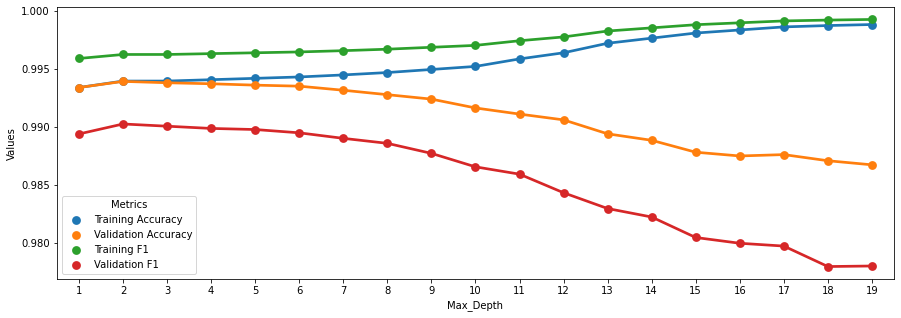

In [186]:
training_accuracy = []
val_accuracy = []
training_f1 = []
val_f1 = []
tree_depths = []

for depth in range(1,20):
    tree_clf = DecisionTreeClassifier(max_depth=depth)
    tree_clf.fit(X_train,y_train)
    y_training_pred = tree_clf.predict(X_train)

    training_acc = accuracy_score(y_train,y_training_pred)
    train_f1 = f1_score(y_train,y_training_pred)
    val_mean_f1 = cross_val_score(tree_clf,X_train,y_train,cv=5,scoring='f1_macro').mean()
    val_mean_accuracy = cross_val_score(tree_clf,X_train,y_train,cv=5,scoring='accuracy').mean()
    
    training_accuracy.append(training_acc)
    val_accuracy.append(val_mean_accuracy)
    training_f1.append(train_f1)
    val_f1.append(val_mean_f1)
    tree_depths.append(depth)
    

Tuning_Max_depth = {"Training Accuracy": training_accuracy, "Validation Accuracy": val_accuracy, "Training F1": training_f1, "Validation F1":val_f1, "Max_Depth": tree_depths }
Tuning_Max_depth_df = pd.DataFrame.from_dict(Tuning_Max_depth)

plot_df = Tuning_Max_depth_df.melt('Max_Depth',var_name='Metrics',value_name="Values")

fig,ax = plt.subplots(figsize=(15,5))
sns.pointplot(x="Max_Depth", y="Values",hue="Metrics", data=plot_df,ax=ax)

From above graph, we can conclude that keeping 'Max_Depth' = 3 will yield optimum Test accuracy and F1 score Optimum.

**Visulazing Decision Tree with Max Depth = 3**

In [198]:
from sklearn import tree

In [199]:
tree_clf = tree.DecisionTreeClassifier(max_depth = 3)
tree_clf.fit(X_train,y_train)

DecisionTreeClassifier(max_depth=3)

[Text(604.5, 475.65000000000003, 'X[13] <= 0.5\ngini = 0.307\nsamples = 33982\nvalue = [6445, 27537]'),
 Text(372.0, 339.75, 'X[14] <= 20006.0\ngini = 0.059\nsamples = 6625\nvalue = [6423, 202]'),
 Text(186.0, 203.85000000000002, 'X[1] <= 15586.0\ngini = 0.154\nsamples = 1309\nvalue = [1199, 110]'),
 Text(93.0, 67.94999999999999, 'gini = 0.149\nsamples = 1295\nvalue = [1190, 105]'),
 Text(279.0, 67.94999999999999, 'gini = 0.459\nsamples = 14\nvalue = [9, 5]'),
 Text(558.0, 203.85000000000002, 'X[0] <= 1006485504.0\ngini = 0.034\nsamples = 5316\nvalue = [5224, 92]'),
 Text(465.0, 67.94999999999999, 'gini = 0.5\nsamples = 2\nvalue = [1, 1]'),
 Text(651.0, 67.94999999999999, 'gini = 0.034\nsamples = 5314\nvalue = [5223, 91]'),
 Text(837.0, 339.75, 'X[14] <= 3779.5\ngini = 0.002\nsamples = 27357\nvalue = [22, 27335]'),
 Text(744.0, 203.85000000000002, 'gini = 0.0\nsamples = 19\nvalue = [19, 0]'),
 Text(930.0, 203.85000000000002, 'X[3] <= 223.5\ngini = 0.0\nsamples = 27338\nvalue = [3, 2733

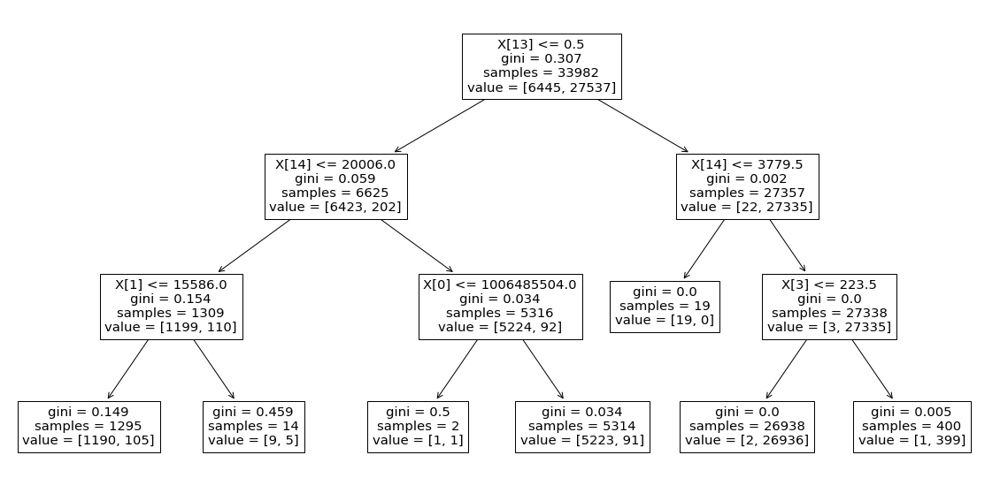

In [201]:
plt.figure(figsize=(20,10))
tree.plot_tree(tree_clf)

From above tree, we could see that some of the leafs have less than 20 samples hence our classifier might overfit. We can sweep hyper-parameter 'min_samples_leaf' to further improve test accuracy by keeping max_depth to 3

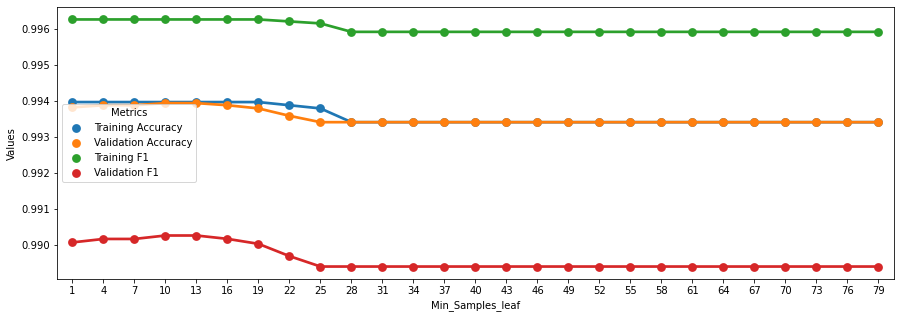

In [203]:
training_accuracy = []
val_accuracy = []
training_f1 = []
val_f1 = []
min_samples_leaf = []
import numpy as np
for samples_leaf in range(1,80,3): ### Sweeping from 1% samples to 10% samples per leaf 
    tree_clf = DecisionTreeClassifier(max_depth=3,min_samples_leaf = samples_leaf)
    tree_clf.fit(X_train,y_train)
    y_training_pred = tree_clf.predict(X_train)

    training_acc = accuracy_score(y_train,y_training_pred)
    train_f1 = f1_score(y_train,y_training_pred)
    val_mean_f1 = cross_val_score(tree_clf,X_train,y_train,cv=5,scoring='f1_macro').mean()
    val_mean_accuracy = cross_val_score(tree_clf,X_train,y_train,cv=5,scoring='accuracy').mean()
    
    training_accuracy.append(training_acc)
    val_accuracy.append(val_mean_accuracy)
    training_f1.append(train_f1)
    val_f1.append(val_mean_f1)
    min_samples_leaf.append(samples_leaf)
    

Tuning_min_samples_leaf = {"Training Accuracy": training_accuracy, "Validation Accuracy": val_accuracy, "Training F1": training_f1, "Validation F1":val_f1, "Min_Samples_leaf": min_samples_leaf }
Tuning_min_samples_leaf_df = pd.DataFrame.from_dict(Tuning_min_samples_leaf)

plot_df = Tuning_min_samples_leaf_df.melt('Min_Samples_leaf',var_name='Metrics',value_name="Values")
fig,ax = plt.subplots(figsize=(15,5))
sns.pointplot(x="Min_Samples_leaf", y="Values",hue="Metrics", data=plot_df,ax=ax)

From above plot, we will choose Min_Samples_leaf to 35 to improve test accuracy.

In [205]:
from sklearn.metrics import confusion_matrix
tree_clf = DecisionTreeClassifier(max_depth=3,min_samples_leaf = 35)
tree_clf.fit(X_train,y_train)
y_pred = tree_clf.predict(X_test)
print("Test Accuracy: ",accuracy_score(y_test,y_pred))
print("Test F1 Score: ",f1_score(y_test,y_pred))
print("Confusion Matrix on Test Data")
pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted'], margins=True)

Test Accuracy:  0.9943014074836938
Test F1 Score:  0.9964754342010278
Confusion Matrix on Test Data


Predicted,0,1,All
True,,,
0,2749,7,2756
1,76,11733,11809
All,2825,11740,14565


## Random Forest

In [165]:
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier()

In [166]:
model.fit(X_train,y_train)

RandomForestClassifier()

In [167]:
model.score(X_test, y_test)

0.9944387229660144

In [168]:
from sklearn.model_selection import learning_curve

In [170]:
fi = pd.DataFrame({'feature': X_train.columns, 'importance': model.feature_importances_}).sort_values(by='importance', ascending=False)
fi = fi.reset_index()
fi

,index,feature,importance
0,13,ChgOffDate,0.819978
1,0,LoanNr_ChkDgt,0.020908
2,20,ApprovalYear,0.018621
3,14,DisbursementGross,0.016798
4,17,DisbursementYear,0.016361
5,9,FranchiseCode,0.013339
6,4,ApprovalFY,0.012939
7,2,Bank,0.008718
8,8,RetainedJob,0.008587
9,1,City,0.008584


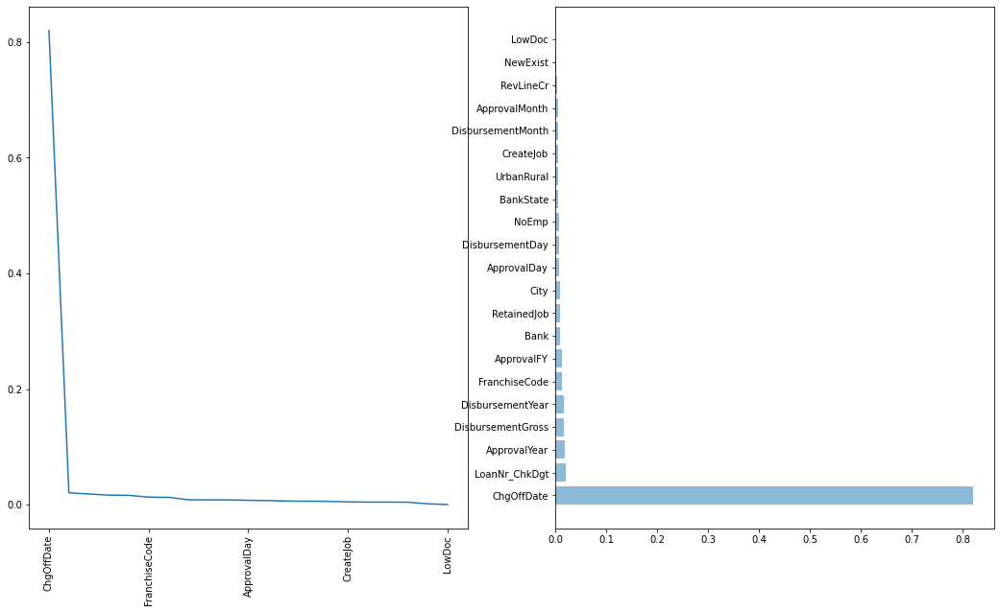

In [171]:
def plot_feature_importance(fi):
    fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(18,10))
    ax1.plot(np.arange(0, len(fi.index)), fi['importance'])
    label_nrs = np.arange(0, len(fi.index), 5 )
    ax1.set_xticks(label_nrs)
    ax1.set_xticklabels(fi['feature'][label_nrs], rotation=90)
    
    num_bar = min(len(fi.index), 30)
    ax2.barh(np.arange(0, num_bar), fi['importance'][:num_bar], align='center', alpha=0.5)
    ax2.set_yticks(np.arange(0, num_bar))
    ax2.set_yticklabels(fi['feature'][:num_bar])

plot_feature_importance(fi)

In [181]:
from sklearn.model_selection import learning_curve
from sklearn.model_selection import cross_val_score, KFold, StratifiedKFold
from sklearn.metrics import classification_report

In [182]:
# Cross-validationt
cv = KFold(n_splits=5, shuffle=False, random_state=33)
# StratifiedKFold has is a variation of k-fold which returns stratified folds:
# each set contains approximately the same percentage of samples of each target class as the complete set.
#cv = StratifiedKFold(y, n_folds=3, shuffle=False, random_state=33)
scores = cross_val_score(model, X, y, cv=cv)
print("Scores in every iteration", scores)
print("Accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

D:\Annaconda\lib\site-packages\sklearn\model_selection\_split.py:293: FutureWarning: Setting a random_state has no effect since shuffle is False. This will raise an error in 0.24. You should leave random_state to its default (None), or set shuffle=True.
  warnings.warn(


Scores in every iteration [0.9938208  0.99351184 0.99433515 0.99361417 0.99392316]
Accuracy: 0.99 (+/- 0.00)


In [183]:
def plot_learning_curve(estimator, title, X, y, axes=None, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    """
    Generate 3 plots: the test and training learning curve, the training
    samples vs fit times curve, the fit times vs score curve.

    Parameters
    ----------
    estimator : estimator instance
        An estimator instance implementing `fit` and `predict` methods which
        will be cloned for each validation.

    title : str
        Title for the chart.

    X : array-like of shape (n_samples, n_features)
        Training vector, where ``n_samples`` is the number of samples and
        ``n_features`` is the number of features.

    y : array-like of shape (n_samples) or (n_samples, n_features)
        Target relative to ``X`` for classification or regression;
        None for unsupervised learning.

    axes : array-like of shape (3,), default=None
        Axes to use for plotting the curves.

    ylim : tuple of shape (2,), default=None
        Defines minimum and maximum y-values plotted, e.g. (ymin, ymax).

    cv : int, cross-validation generator or an iterable, default=None
        Determines the cross-validation splitting strategy.
        Possible inputs for cv are:

          - None, to use the default 5-fold cross-validation,
          - integer, to specify the number of folds.
          - :term:`CV splitter`,
          - An iterable yielding (train, test) splits as arrays of indices.

        For integer/None inputs, if ``y`` is binary or multiclass,
        :class:`StratifiedKFold` used. If the estimator is not a classifier
        or if ``y`` is neither binary nor multiclass, :class:`KFold` is used.

        Refer :ref:`User Guide <cross_validation>` for the various
        cross-validators that can be used here.

    n_jobs : int or None, default=None
        Number of jobs to run in parallel.
        ``None`` means 1 unless in a :obj:`joblib.parallel_backend` context.
        ``-1`` means using all processors. See :term:`Glossary <n_jobs>`
        for more details.

    train_sizes : array-like of shape (n_ticks,)
        Relative or absolute numbers of training examples that will be used to
        generate the learning curve. If the ``dtype`` is float, it is regarded
        as a fraction of the maximum size of the training set (that is
        determined by the selected validation method), i.e. it has to be within
        (0, 1]. Otherwise it is interpreted as absolute sizes of the training
        sets. Note that for classification the number of samples usually have
        to be big enough to contain at least one sample from each class.
        (default: np.linspace(0.1, 1.0, 5))
    """
    if axes is None:
        _, axes = plt.subplots(1, 3, figsize=(20, 5))

    axes[0].set_title(title)
    if ylim is not None:
        axes[0].set_ylim(*ylim)
    axes[0].set_xlabel("Training examples")
    axes[0].set_ylabel("Score")

    train_sizes, train_scores, test_scores, fit_times, _ = \
        learning_curve(estimator, X, y, cv=cv, n_jobs=n_jobs,
                       train_sizes=train_sizes,
                       return_times=True)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    fit_times_mean = np.mean(fit_times, axis=1)
    fit_times_std = np.std(fit_times, axis=1)

    # Plot learning curve
    axes[0].grid()
    axes[0].fill_between(train_sizes, train_scores_mean - train_scores_std,
                         train_scores_mean + train_scores_std, alpha=0.1,
                         color="r")
    axes[0].fill_between(train_sizes, test_scores_mean - test_scores_std,
                         test_scores_mean + test_scores_std, alpha=0.1,
                         color="g")
    axes[0].plot(train_sizes, train_scores_mean, 'o-', color="r",
                 label="Training score")
    axes[0].plot(train_sizes, test_scores_mean, 'o-', color="g",
                 label="Cross-validation score")
    axes[0].legend(loc="best")

    # Plot n_samples vs fit_times
    axes[1].grid()
    axes[1].plot(train_sizes, fit_times_mean, 'o-')
    axes[1].fill_between(train_sizes, fit_times_mean - fit_times_std,
                         fit_times_mean + fit_times_std, alpha=0.1)
    axes[1].set_xlabel("Training examples")
    axes[1].set_ylabel("fit_times")
    axes[1].set_title("Scalability of the model")

    # Plot fit_time vs score
    axes[2].grid()
    axes[2].plot(fit_times_mean, test_scores_mean, 'o-')
    axes[2].fill_between(fit_times_mean, test_scores_mean - test_scores_std,
                         test_scores_mean + test_scores_std, alpha=0.1)
    axes[2].set_xlabel("fit_times")
    axes[2].set_ylabel("Score")
    axes[2].set_title("Performance of the model")

    return plt


<module 'matplotlib.pyplot' from 'D:\\Annaconda\\lib\\site-packages\\matplotlib\\pyplot.py'>

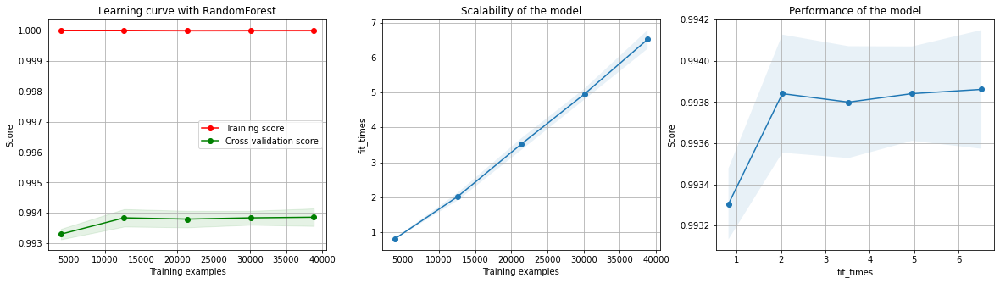

In [184]:
from sklearn.model_selection import learning_curve

plot_learning_curve(model, "Learning curve with RandomForest", X, y, cv=cv)

In [209]:
rf_clf = RandomForestClassifier(n_estimators=100,max_depth=3,min_samples_leaf = 10)
rf_clf.fit(X_train,y_train)
y_pred = rf_clf.predict(X_train)
print(rf_clf.score(X_test, y_test))
print("Train F1 Score ", f1_score(y_train,y_pred))
print("Train Accuracy ", accuracy_score(y_train,y_pred))

print("Validation Mean F1 Score: ",cross_val_score(rf_clf,X_train,y_train,cv=5,scoring='f1_macro').mean())
print("Validation Mean Accuracy: ",cross_val_score(rf_clf,X_train,y_train,cv=5,scoring='accuracy').mean())

0.9725369035358736
Train F1 Score  0.982577771391623
Train Accuracy  0.9714554764286976
Validation Mean F1 Score:  0.9744440866279145
Validation Mean Accuracy:  0.9854929982872511


Validation Accuracy > Train Accuracy ==> No Overfitting

In [210]:
y_pred = rf_clf.predict(X_test)
print("Test Accuracy: ",accuracy_score(y_test,y_pred))
print("Test F1 Score: ",f1_score(y_test,y_pred))
print("Confusion Matrix on Test Data")
pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted'], margins=True)

Test Accuracy:  0.9725369035358736
Test F1 Score:  0.9832551908908238
Confusion Matrix on Test Data


Predicted,0,1,All
True,,,
0,2421,335,2756
1,65,11744,11809
All,2486,12079,14565


In [355]:
ids_test = df_test_nolabel['id']

features= ['LoanNr_ChkDgt', 'City', 'Bank', 'BankState', 'ApprovalFY', 'NoEmp',
       'NewExist', 'CreateJob', 'RetainedJob', 'FranchiseCode', 'UrbanRural',
       'RevLineCr', 'LowDoc', 'ChgOffDate', 'DisbursementGross',
       'DisbursementDay', 'DisbursementMonth', 'DisbursementYear',
       'ApprovalDay', 'ApprovalMonth', 'ApprovalYear']

X=df_test_nolabel[features]
y_pred=rf_clf.predict(X)

In [356]:
results = df_test_nolabel[["id"]]
results["AcceptFloat"] = y
results["Accept"] = results["AcceptFloat"].values.astype(int)
results.drop(['AcceptFloat'], axis=1, inplace=True)
results["id"].size

<ipython-input-356-37a37cf3d9b6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  results["AcceptFloat"] = y
<ipython-input-356-37a37cf3d9b6>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  results["Accept"] = results["AcceptFloat"].values.astype(int)
D:\Annaconda\lib\site-packages\pandas\core\frame.py:3990: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#r

7994

In [357]:
results.to_csv("resultsRandomForest.csv", index_label=False, index=False)

In [358]:
ids_test

0       6b460a6cfab
1       2ace454000f
2       cfdced145b2
3       00a997fa48d
4       4a4cbc40146
           ...     
7989    142ed6bb026
7990    906d828c794
7991    d1627e78749
7992    fdabee6c01e
7993    abc900f32db
Name: id, Length: 7994, dtype: object